# Печь Ванюкова
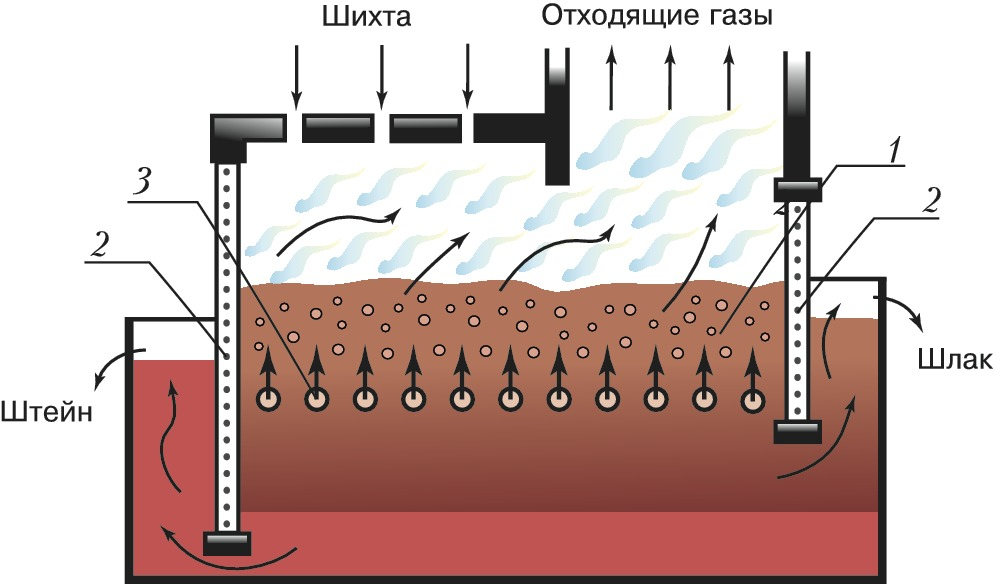
1 - ванна с расплавом, 2 - кессоны(водоохлаждаемые элементы печи для регуляции температуры), 3 - фурмы для подачи дутья


<div style="font-size: 20px">
    Ванюкова процесс(процесс плавки в расплаве)<div/><div style="font-size: 17px"> - непрерывный пирометаллургический процесс переработки природного сырья, промежуточных продуктов металлругического производства, промышленных и бытовых отходов с получением жидких и газообразных продуктов.<div/>
Печь представляет собой прямоугольную ванну (шириной 1.5-2.5 м, высотой 6-6.5 м, длиной 4-30 м), ограждение шахты выполнено из охлаждаемых водой кессонов для продления эксплуатационного цикла печи. В средней части стенок расположены фурмы для подачи дутья(воздуха, обогащенного до 90% кислородом), в торцевых стенах - сифоны для непрерывного удаления щлака и штейна. Отходящие газы поднимаются в котёл-утилизатор.

# Технология плавки
<div style="font-size: 17px">
    Перерабатываемую шихту размером частиц от 0.045 до 100 мм и кислородсодержащее дутьё подают непосредственно в ванну с расплавленным шлаком, в которой происходит плавка и окисление шихты. Дутьё разделяет шлак на верхнюю перемешиваемую газом зону и нижнюю - зону спокойного шлака. В верхней зоне дутьё создаёт энергичное турбулентное движение, благодаря которому тепло- и массообмен между твёрдыми частицами, расплавом и газом ускоряется в сотни раз. 
<div/>

<div style="font-size: 17px">
    Необходимая для плавки теплота генерируется в ходе экзометрической реакции окисления шихты ксислородом дутья и добавляетсямого углеродсодержащего топлива. В перемешиваемой зоне в результате многократных соударений происходит укрупнение образующихся капель штейна (или металла), которые опускаются через нижнюю зону спокойного шлака, образуя донный слой, а газообразные продукты плавки поднимаются снизу(от места введения дутья в расплав) вверх. 
    <div/>

<div style="font-size: 17px">
   Основное достоинство процесса Ванюкова - высокая производительность, а также возможность вести плавку до штейна или металла с полной утилизацией всех полезных составляющих сырья. В получаемом штейне содержание меди достигает 45-66%, что является очень высоким показателем. Кроме того, на выходе можно получать богатый серосодержащий отходящий газ. 
    <div/>

In [712]:
# Data manipulation
import numpy as np
import pandas as pd
import os
from pathlib import Path
from sklearn.feature_selection import VarianceThreshold
from datetime import timedelta
import math
from tqdm import tqdm
# Visualization
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
%config InlineBackend.figure_formats = ['svg']

# Machine Learning
from math import sqrt
from sklearn.linear_model import SGDRegressor, LinearRegression, MultiTaskElasticNet
from sklearn import metrics, tree
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.cross_decomposition import PLSRegression
from sklearn.model_selection import TimeSeriesSplit, GridSearchCV, RandomizedSearchCV, train_test_split, learning_curve, cross_val_score, KFold
from sklearn.metrics import make_scorer, mean_squared_error,mean_absolute_error
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.utils import resample
from scipy.stats import shapiro, probplot
from statsmodels.stats.stattools import durbin_watson
from sklearn.pipeline import make_pipeline, Pipeline
from numpy.polynomial import Polynomial
import warnings
import random

In [666]:
warnings.filterwarnings('ignore')
random.seed(21)
np.random.seed(21)

In [667]:
stein = pd.read_csv('stein.csv')
load1 = pd.read_csv('data1.csv')
load2 = pd.read_csv('data2.csv')
load3 = pd.read_csv('data3.csv')

In [668]:
load1.columns

Index(['Date', 'blast furnace pressure, point 1',
       'blast furnace pressure, point 2', 'natural gas pressure',
       'conveyor 31, productivity', 'conveyor 31, speed',
       'conveyor 32, productivity', 'conveyor 32, speed', 'feeder 1, level',
       'feeder 1, speed', 'feeder 1, productivity', 'feeder 2, level',
       'feeder 2, speed', 'feeder 2, productivity', 'feeder 3, level',
       'feeder 3, speed', 'feeder 3, productivity', 'feeder 4, level',
       'feeder 4, speed', 'feeder 4, productivity', 'feeder 5, level',
       'feeder 5, speed', 'feeder 5, productivity', 'feeder 6, level',
       'feeder 6, speed', 'feeder 6, productivity', 'feeder 7, speed',
       'feeder 8, speed', 'feeder 7, level', 'feeder 8, level',
       'vacuum in the bunker', 'Overall blast volume, m3/h',
       'natural gas flow',
       'Oxygen content in the blast (degree of oxygen enrichment in the blowing), %',
       'blast furnace temperature',
       'Temperature of exhaust gases in the off-g

In [669]:
stein.columns

Index(['Measurement ID', 'Date', '[Cu]', '[Ni]', '[Fe]', '[S]'], dtype='object')

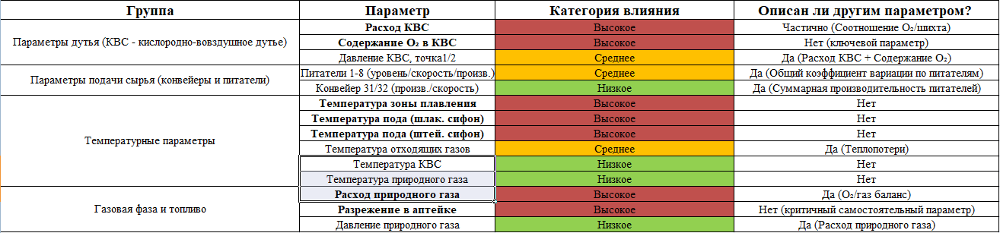

In [670]:
df_influence = pd.DataFrame({
    'Группа': ['Параметры дутья']*3 + ['Параметры подачи сырья']*2 + ['Температурные параметры']*6 + ['Газовая фаза']*3,
    'Параметр': ['Расход КВС', 'Содержание O₂ в КВС', 'Давление КВС', 'Питатели, скорость (х8)', 'Конвейеры, скорость (х2)', 
                'Температура плавления (х2)', 'Температура шлака', 'Температура штейна', 
                'Температура отходящих газов', 'Температура КВС', 'Температура природного газа',
                'Расход природного газа', 'Разрежение в аптейке', 'Давление природного газа'],
    'Влияние': ['Высокое']*2 + ['Среднее'] + ['Среднее'] + ['Низкое'] + 
              ['Высокое']*3 + ['Среднее'] + ['Низкое']*2 + 
              ['Высокое']*2 + ['Низкое'], 
    'Описан': ['Частично', 'Нет', 'Да', 'Да', 'Да', 
              'Нет', 'Нет', 'Нет', 'Да', 'Нет', 'Нет',
              'Да', 'Нет', 'Да']
})

fig = px.treemap(df_influence, 
                 path=['Группа', 'Параметр'],
                 color='Влияние',
                 color_discrete_map={'Высокое':'#e74c3c', 'Среднее':'#f39c12', 'Низкое':'#2ecc71'},
                 width=1200, 
                 height=800)

# Настройка шрифтов и центрирование
fig.update_layout(
    title={
        'text': "Влияние параметров печи Ванюкова на содержание меди",
        'y':0.98,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 24}
    },
    font=dict(
        family="Arial",
        size=18,  
        color="#333333"
    ),
    margin=dict(t=50, l=25, r=25, b=25)
)

# Настройка отображения текста внутри блоков
fig.update_traces(
    textfont=dict(size=20),  
    textposition="middle center",  
    insidetextfont=dict(size=18)  
)

fig.show()

In [671]:
fig = px.sunburst(
    df_influence,
    path=['Группа', 'Параметр'],
    color='Влияние',
    color_discrete_map={
        'Высокое': '#e74c3c',
        'Среднее': '#f39c12',
        'Низкое': '#2ecc71'
    },
    hover_data=['Описан'],
    width=800,
    height=800
)

fig.update_traces(
    textinfo='label+percent parent',
    insidetextorientation='radial'
)

fig.update_layout(
    title_text='Иерархия влияния параметров печи Ванюкова',
    title_x=0.5
)

fig.show()

In [672]:
expected_params = ['Date','temperature of the feed, matte siphon', 
    'temperature of the feed, melting zone, point 1',
    'temperature of the feed, melting zone, point 2',
    'temperature of the feed, slag siphon', 
     'vacuum in the bunker', 'natural gas flow', 'Overall blast volume, m3/h',
     'Oxygen content in the blast (degree of oxygen enrichment in the blowing), %',
     'feeder 1, speed', 'feeder 2, speed', 'feeder 3, speed', 'feeder 4, speed', 
     'feeder 5, speed', 'feeder 6, speed', 'feeder 7, speed','feeder 8, speed']

# Data Preprocessing

In [673]:
column_mapping = {'[Cu]':'Cu, %', '[Ni]':'Ni, %', '[Fe]':'Fe, %', '[S]':'S, %'}

stein = stein.drop("Measurement ID",axis=1)
stein.rename(columns=column_mapping, inplace=True)
stein.describe()

,"Cu, %","Ni, %","Fe, %","S, %"
count,1718.000000,1718.000000,1718.000000,1718.000000
mean,57.965017,3.475023,14.582014,23.280093
std,3.083659,0.458842,2.549130,0.541035
min,46.100000,2.350000,6.900000,20.000000
25%,55.900000,3.120000,12.900000,23.000000
50%,58.000000,3.455000,14.500000,23.300000
75%,59.900000,3.820000,16.300000,23.600000
max,67.500000,4.960000,24.200000,25.400000


In [674]:
stein['Date'] = pd.to_datetime(stein['Date'])

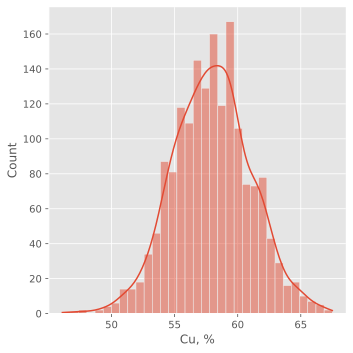

In [675]:
sns.displot(stein['Cu, %'], kde = True)

In [676]:
#skewness and kurtosis
print("Асимметрия: %f" % stein['Cu, %'].skew())
print("Эксцесс: %f" % stein['Cu, %'].kurt())

Асимметрия: -0.011056
Эксцесс: 0.146055


1. Ассиметрия (skewness) примерно равна нулю, значит значения нормально распределены от среднего. 
2. Эксцесс (kurtosis) также относительно значений не критично, в центральной точке нет скопления значений.
3. Распределение считаем нормальным

Устранение NaN

In [677]:
stein[stein.isna().any(axis=1)]

,Date,"Cu, %","Ni, %","Fe, %","S, %"
65,2020-01-06 11:00:00,NaN,NaN,NaN,NaN
66,2020-01-06 13:00:00,NaN,NaN,NaN,NaN
67,2020-01-06 15:00:00,NaN,NaN,NaN,NaN
68,2020-01-06 17:00:00,NaN,NaN,NaN,NaN
69,2020-01-06 19:00:00,NaN,NaN,NaN,NaN
...,...,...,...,...,...
1793,2020-05-29 11:00:00,NaN,NaN,NaN,NaN
1794,2020-05-29 13:00:00,NaN,NaN,NaN,NaN
1795,2020-05-29 15:00:00,NaN,NaN,NaN,NaN
1796,2020-05-29 17:00:00,NaN,NaN,NaN,NaN


In [678]:
stein['Cu, %'] = stein['Cu, %'].fillna(stein['Cu, %'].mean())
stein['Ni, %'] = stein['Ni, %'].fillna(stein['Ni, %'].mean())
stein['Fe, %'] = stein['Fe, %'].fillna(stein['Fe, %'].mean())
stein['S, %'] = stein['S, %'].fillna(stein['S, %'].mean())

In [1163]:
X_lin = load_df.merge(stein, how = 'inner',on = 'Date').drop(['Date', 'Cu, %', 'Ni, %', 'Fe, %', 'S, %'],axis=1)

In [1172]:
model = LinearRegression()

In [1175]:
model = model.fit(X_lin, stein['Cu, %'][0:len(X_lin)])

In [1170]:
stein.describe()

,Date,"Cu, %","Ni, %","Fe, %","S, %"
count,1844,1844.000000,1844.000000,1844.000000,1844.000000
mean,2020-03-16 19:47:30.325379328,57.965017,3.475023,14.582014,23.280093
min,2020-01-01 01:00:00,46.100000,2.350000,6.900000,20.000000
25%,2020-02-03 10:30:00,56.000000,3.140000,13.000000,23.000000
50%,2020-03-17 20:00:00,57.965017,3.475023,14.582014,23.280093
75%,2020-04-25 05:30:00,59.725000,3.780000,16.200000,23.600000
max,2020-06-02 15:00:00,67.500000,4.960000,24.200000,25.400000
std,NaN,2.976383,0.442879,2.460449,0.522214


In [680]:
load_df = pd.concat([load1, load2, load3], ignore_index=True)

In [681]:
load_df['Date'] = pd.to_datetime(load_df['Date'])

In [682]:
load_df.shape

(217908, 41)

In [1157]:
load_df = load_df.rename(columns={'Oxygen content in the blast (degree of oxygen enrichment in the blowing), %':'Oxygen content in the blast, %'})

DataFrame для графиков

In [944]:
columns={
    'blast furnace pressure, point 1': 'давление КВС, точка1',
    'blast furnace pressure, point 2': 'давление КВС, точка2',
    'natural gas pressure': 'давление природный газ',
    'conveyor 31, productivity': 'конвейер 31, производительность',
    'conveyor 31, speed': 'конвейер 31, скорость',
    'conveyor 32, productivity': 'конвейер 32, производительность',
    'conveyor 32, speed': 'конвейер 32, скорость',
    'feeder 1, level': 'питатель1, уровень',
    'feeder 1, speed': 'питатель1, скорость',
    'feeder 1, productivity': 'питатель1, производительность',
    'feeder 2, level': 'питатель2, уровень',
    'feeder 2, speed': 'питатель2, скорость',
    'feeder 2, productivity': 'питатель2, производительность',
    'feeder 3, level': 'питатель3, уровень',
    'feeder 3, speed': 'питатель3, скорость',
    'feeder 3, productivity': 'питатель3, производительность',
    'feeder 4, level': 'питатель4, уровень',
    'feeder 4, speed': 'питатель4, скорость',
    'feeder 4, productivity': 'питатель4, производительность',
    'feeder 5, level': 'питатель5, уровень',
    'feeder 5, speed': 'питатель5, скорость',
    'feeder 5, productivity': 'питатель5, производительность',
    'feeder 6, level': 'питатель6, уровень',
    'feeder 6, speed': 'питатель6, скорость',
    'feeder 6, productivity': 'питатель6, производительность',
    'feeder 7, speed': 'питатель7, скорость',
    'feeder 8, speed': 'питатель8, скорость',
    'feeder 7, level': 'питатель7, уровень',
    'feeder 8, level': 'питатель8, уровень',
    'vacuum in the bunker': 'разрежение в аптейке, Па',
    'Overall blast volume, m3/h': 'расход КВС, м3/ч',
    'natural gas flow': 'расход природного газа, м3/ч',
    'Oxygen content in the blast, %': 'содержание кислорода в КВС, %',
    'blast furnace temperature': 'температура КВС',
    'Temperature of exhaust gases in the off-gas duct, °C': 'температура отходящих газов в аптейке',
    'temperature of the feed, slag siphon': 'температура пода, шлаковый сифон',
    'temperature of the feed, matte siphon': 'температура пода, штейновый сифон',
    'temperature of the feed, melting zone, point 1': 'температура пода, зона плавления, точка1',
    'temperature of the feed, melting zone, point 2': 'температура пода, зона плавления, точка2',
    'temperature of natural gas': 'температура природного газа',
    'feeder_speed_cv': 'коэффициент вариации скорости питателей',
    'total_feeder_speed': 'суммарная скорость подачи питателей',
    'Temperature of feed in the smelting zone, °C': 'средняя температура пода в зоне плавления, °C',
    'blast_heat_potential': 'тепловой потенциал дутья',
    'specific_heat_flow': 'удельный тепловой поток',
    'temp_siphon_diff': 'скорость изменения температуры штейнового сифона',
    'temp_melt_diff': 'скорость изменения температуры в зоне плавления'}

In [684]:
stein['Date'].agg(['min','max']) - load_df['Date'].agg(['min','max'])

min     0 days 01:00:00
max   -1 days +23:17:00
Name: Date, dtype: timedelta64[ns]

In [685]:
# Убираем избыточные данные о загрузке 
load_df = load_df[load_df['Date'] < stein['Date'].max()]

In [977]:
load_df.shape

(160518, 39)

In [686]:
load_df[load_df.isna().any(axis=1)]

,Date,"blast furnace pressure, point 1","blast furnace pressure, point 2",natural gas pressure,"conveyor 31, productivity","conveyor 31, speed","conveyor 32, productivity","conveyor 32, speed","feeder 1, level","feeder 1, speed",...,"Overall blast volume, m3/h",natural gas flow,"Oxygen content in the blast (degree of oxygen enrichment in the blowing), %",blast furnace temperature,"Temperature of exhaust gases in the off-gas duct, °C","temperature of the feed, slag siphon","temperature of the feed, matte siphon","temperature of the feed, melting zone, point 1","temperature of the feed, melting zone, point 2",temperature of natural gas


Рассмотрим Boxplot выбранных признаков для устранения выбросов

In [687]:
expected_params

['Date',
 'temperature of the feed, matte siphon',
 'temperature of the feed, melting zone, point 1',
 'temperature of the feed, melting zone, point 2',
 'temperature of the feed, slag siphon',
 'vacuum in the bunker',
 'natural gas flow',
 'Overall blast volume, m3/h',
 'Oxygen content in the blast (degree of oxygen enrichment in the blowing), %',
 'feeder 1, speed',
 'feeder 2, speed',
 'feeder 3, speed',
 'feeder 4, speed',
 'feeder 5, speed',
 'feeder 6, speed',
 'feeder 7, speed',
 'feeder 8, speed']

In [688]:
load_df_rus = load_df.rename(columns=columns)

In [689]:
expected_params_rus = [columns[x] for x in expected_params]

In [690]:
def plot_boxplots_with_outliers(data, expected_params, ncols = 4, save=False, figsize=(20, 15)):
    """
    Строит боксплоты для параметров в виде сетки n x n с информацией о выбросах
    
    Параметры:
    ----------
    data : pd.DataFrame
        DataFrame с данными
    expected_params : list
        Список параметров для анализа
    ncols : int, optional
        Количество столбцов в сетке, по умолчанию 4
    save : bool, optional
        Сохранение графика
    figsize : tuple, optional
        Размер фигуры (ширина, высота на один график), по умолчанию (20, 15)
    """

    n_params = len(expected_params)
    nrows = math.ceil(n_params / ncols)
    
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, 
                             figsize=figsize)
    
    axes = axes.flatten()
    
    for i, param in enumerate(expected_params):
        ax = axes[i]
        if param in data.columns:
            sns.boxplot(x=data[param], ax=ax, 
                        linewidth=1.5, flierprops=dict(marker='o', markersize=4))
            
            ax.set_title(param, fontsize=18, 
                         fontweight='bold',  
                         pad=10)

            ax.tick_params(axis='x', labelsize=9)
            ax.tick_params(axis='y', labelsize=9)
            
            ax.set_xlabel('')
            
            # Вычисляем выбросы по правилу 1.5*IQR
            q1 = data[param].quantile(0.25)
            q3 = data[param].quantile(0.75)
            iqr = q3 - q1
            lower_bound = q1 - 1.5*iqr
            upper_bound = q3 + 1.5*iqr
            
            outliers = data[(data[param] < lower_bound) | (data[param] > upper_bound)]
            
            # Добавляю информацию о выбросах справа от графика
            if not outliers.empty:
                ax.text(0.95, 0.95, 
                       f'Выбросы: {len(outliers)} ({len(outliers)/len(data)*100:.1f}%)',
                       transform=ax.transAxes, 
                       fontsize=14,
                       color='red',
                       ha='right',
                       va='top',
                       bbox=dict(facecolor='white', alpha=0.8, edgecolor='red', boxstyle='round'))
        else:
            # Если параметр не найден в данных
            ax.set_title(f'Параметр не найден: {param}', color='red')
            ax.set_visible(True)

    for j in range(i+1, len(axes)):
        axes[j].set_visible(False)
        
    plt.tight_layout()
    if(save):plt.savefig('Boxplot_with_outliers.png', dpi=200)
    plt.show()

In [691]:
plot_boxplots_with_outliers(load_df_rus, expected_params_rus[1:], 3)

In [692]:
# Убираем 'температура пода, шлаковый сифон' и 'питатель 8, скорость' - нулевые значения  
zero_params = ['temperature of the feed, slag siphon', 'feeder 8, speed']
expected_params = [x for x in expected_params if x not in zero_params]
load_df = load_df.drop(zero_params,axis=1)

In [1155]:
stein

,Date,"Cu, %","Ni, %","Fe, %","S, %"
0,2020-01-01 01:00:00,65.1,3.73,9.0,22.0
1,2020-01-01 03:00:00,64.6,3.74,9.4,22.2
2,2020-01-01 05:00:00,61.6,3.65,10.9,22.8
3,2020-01-01 07:00:00,59.2,3.52,13.6,23.1
4,2020-01-01 09:00:00,55.0,3.49,16.9,23.8
...,...,...,...,...,...
1839,2020-06-02 07:00:00,56.9,3.10,15.3,23.2
1840,2020-06-02 09:00:00,55.8,3.30,15.9,23.9
1841,2020-06-02 11:00:00,54.1,3.32,17.2,24.2
1842,2020-06-02 13:00:00,55.6,3.15,16.4,24.1


In [693]:
load_df_rus.shape

(217866, 41)

In [694]:
# Удаляем выбросы по правилу 1,5IRQ 

for param in expected_params[1:]: 
    q1 = load_df[param].quantile(0.25)
    q3 = load_df[param].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5*iqr
    upper_bound = q3 + 1.5*iqr
    param_rus = columns[param]
    load_df = load_df[(load_df[param] > lower_bound) & (load_df[param] < upper_bound)]
    load_df_rus = load_df_rus[(load_df_rus[param_rus] > lower_bound) & (load_df_rus[param_rus] < upper_bound)]


In [695]:
# Оставляем ожидаемо влиятельные признаки
expected_df = load_df[expected_params]

In [696]:
expected_df.shape

(160518, 15)

In [697]:
expected_df.columns

Index(['Date', 'temperature of the feed, matte siphon',
       'temperature of the feed, melting zone, point 1',
       'temperature of the feed, melting zone, point 2',
       'vacuum in the bunker', 'natural gas flow',
       'Overall blast volume, m3/h',
       'Oxygen content in the blast (degree of oxygen enrichment in the blowing), %',
       'feeder 1, speed', 'feeder 2, speed', 'feeder 3, speed',
       'feeder 4, speed', 'feeder 5, speed', 'feeder 6, speed',
       'feeder 7, speed'],
      dtype='object')

# Data Engineering

Балансовые показатели:

In [698]:
# Баланс питателей
expected_df['feeder_speed_cv'] = expected_df[[f'feeder {i}, speed' for i in range(1,8)]].std(axis=1) / \
                       expected_df[[f'feeder {i}, speed' for i in range(1,8)]].mean(axis=1)
# Суммарная подача питателей
expected_df['total_feeder_speed'] = expected_df[[f'feeder {i}, speed' for i in range(1,8)]].sum(axis=1)

Тепловые балансы:

In [699]:
# Среднее двух точек температур
expected_df['Temperature of feed in the smelting zone, °C'] = (expected_df['temperature of the feed, melting zone, point 1']\
                                        +expected_df['temperature of the feed, melting zone, point 2'])/2
# Тепловой потенциал дутья:
# теплоемкость дутья ~1.3 кДж/м3*°C 
expected_df['blast_heat_potential'] = expected_df['Overall blast volume, m3/h'] * 1.3 * expected_df['Temperature of feed in the smelting zone, °C']

# Удельный тепловой поток:
# 35 МДж/м3 - теплотворность газа
expected_df['specific_heat_flow'] = (expected_df['natural gas flow'] * 35.0 + expected_df['blast_heat_potential']) / \
                                (expected_df['total_feeder_speed'] + 1e-6)  

Временные производные

In [700]:
# Скорость изменения температур
expected_df['temp_siphon_diff'] = expected_df['temperature of the feed, matte siphon'].diff() 
expected_df['temp_melt_diff'] = expected_df['Temperature of feed in the smelting zone, °C'].diff()

In [701]:
# Исключаем первую строку где производная NaN
expected_df = expected_df.drop(0, axis=0)

In [702]:
expected_df.shape

(160517, 22)

In [ ]:
expected_df_rus = expected_df.rename(columns=columns)

In [954]:
expected_df_rus.columns


Index(['Date', 'температура пода, штейновый сифон',
       'температура пода, зона плавления, точка1',
       'температура пода, зона плавления, точка2', 'разрежение в аптейке, Па',
       'расход природного газа, м3/ч', 'расход КВС, м3/ч',
       'Содержание кислорода в КВС, %', 'питатель1, скорость',
       'питатель2, скорость', 'питатель3, скорость', 'питатель4, скорость',
       'питатель5, скорость', 'питатель6, скорость', 'питатель7, скорость',
       'коэффициент вариации скорости питателей',
       'суммарная скорость подачи питателей',
       'средняя температура пода в зоне плавления, °C',
       'тепловой потенциал дутья', 'удельный тепловой поток',
       'скорость изменения температуры штейнового сифона',
       'скорость изменения температуры в зоне плавления'],
      dtype='object')

In [953]:
expected_df_rus = expected_df_rus.rename(columns = {'Дата':'Date'})

# Data Agregation

Каждое измерение состава (Y) происходит раз в 2 часа. Данные с датчиков о загрузке печи (X) замеряются раз в 1 минуту.

In [715]:
def get_window_data(y_date, X, min_points=5):
    """
    Возвращает окно интервалом 2 часа
    
    Параметры:
    ----------
    y_date : datetime64[ns]
        Дата конца интервала
    X : pd.DataFrame
        DataFrame с данными
    min_points : int, optional
        Минимальное количество точек в окне, по умолчанию 5
    """
    start = y_date - timedelta(hours=2)
    end = y_date
    window = X[(X['Date'] >= start) & (X['Date'] < end)]
    
    return window

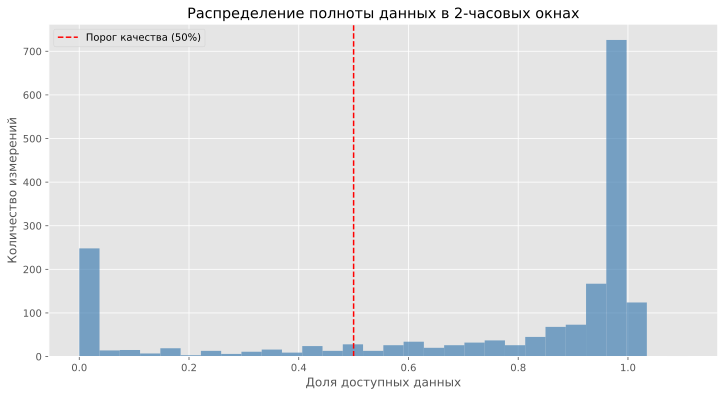

In [988]:
# Распределение полноты данных
density_values = [len(get_window_data(row['Date'], expected_df, min_points=0)) / 120 
                 for _, row in stein.iterrows()]

plt.figure(figsize=(12, 6))
plt.hist(density_values, bins=30, alpha=0.7, color='steelblue')
plt.axvline(x=0.5, color='r', linestyle='--', label='Порог качества (50%)')
plt.title("Распределение полноты данных в 2-часовых окнах")
plt.xlabel("Доля доступных данных")
plt.ylabel("Количество измерений")
plt.legend()
plt.show()

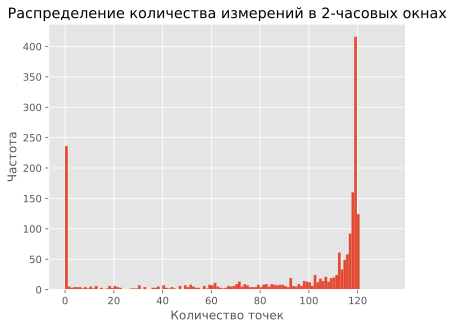

In [705]:
# Проверка распределения количества точек в окнах
window_counts = [len(get_window_data(row['Date'], expected_df, min_points=0)) 
                for _, row in stein.iterrows()]

plt.hist(window_counts, bins=120)
plt.title("Распределение количества измерений в 2-часовых окнах")
plt.xlabel("Количество точек")
plt.ylabel("Частота")
plt.show()

Агрегация данных X: Для каждого 2-часового окна рассчитаны статистики:

Среднее, медиана, стандартное отклонение

Минимум, максимум

Тренд (скорость изменения) путём вычисления коэффициента линейной регрессии по данным за 2 часа

Полнота данных - количество точек в 2-х часовом окне

In [955]:
def aggregate_features(window):
    
    numeric_cols = window.select_dtypes(include=[np.number]).columns
    stats = {}
    n = len(window)
    
    # Базовые статистики
    for col in numeric_cols:
        col_data = window[col]
        stats[f"{col}_mean"] = np.mean(col_data)
        stats[f"{col}_median"] = np.median(col_data)
        stats[f"{col}_min"] = np.min(col_data)
        stats[f"{col}_max"] = np.max(col_data)
        
        # Std только при достаточном количестве точек
        stats[f"{col}_std"] = np.std(col_data) 
        
        # Тренды с проверкой достаточности данных
        x = np.arange(n)
        stats[f"{col}_trend"] = np.polyfit(x, col_data, 1)[0]
        
    
    stats["Полнота данных"] = n / 120  # Полнота данных
    return pd.Series(stats)
    

In [956]:
stein.columns

Index(['Date', 'Cu, %', 'Ni, %', 'Fe, %', 'S, %'], dtype='object')

In [1049]:
features = []
targets = []
for index, row in tqdm(stein.iterrows(), total=len(stein)):
    window = get_window_data(row['Date'], expected_df_rus)
    if len(window) >= 120*0.2:  # Минимальное количество точек для статистики
        agg_features = aggregate_features(window)
        features.append(agg_features)
        targets.append(row['Cu, %'])

100%|█████████████████████████████████████████████████████████████████████████████| 1844/1844 [00:11<00:00, 157.35it/s]


Text(0, 0.5, 'Ошибка тренда')

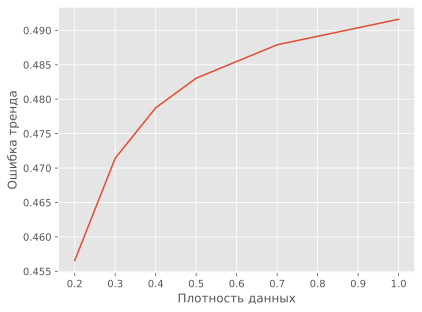

In [1050]:
# Тест стабильности тренда при разной плотности данных
densities = [0.2, 0.3, 0.4, 0.5, 0.7, 1.0]
trend_stability = []

for d in densities:
    errors = []
    for _ in range(1000):
        # Генерация данных с известным трендом
        n_points = int(120 * d)
        x = np.linspace(0, 2, n_points)  # 2 часа
        y = 0.5 * x + np.random.normal(0, 0.2, n_points)
        
        # Расчет тренда
        trend = np.polyfit(np.arange(n_points), y, 1)[0]
        errors.append(abs(trend - 0.5))
    
    trend_stability.append(np.mean(errors))

plt.plot(densities, trend_stability)
plt.xlabel('Плотность данных')
plt.ylabel('Ошибка тренда')

In [1051]:
len(features)

1538

In [1052]:
features_df = pd.DataFrame(features)
targets_df = pd.DataFrame(targets, columns = ['Cu, %'])

In [1053]:
# Индексы NaN строк в обоих DF
na_indices = (targets_df[targets_df.isna().any(axis=1)].index).append(features_df[features_df.isna().any(axis=1)].index)

In [1054]:
targets_df = targets_df.drop(na_indices, axis=0).reset_index(drop=True)

In [1055]:
features_df = features_df.drop(na_indices, axis=0).reset_index(drop=True)

In [1056]:
features_df.columns

Index(['температура пода, штейновый сифон_mean',
       'температура пода, штейновый сифон_median',
       'температура пода, штейновый сифон_min',
       'температура пода, штейновый сифон_max',
       'температура пода, штейновый сифон_std',
       'температура пода, штейновый сифон_trend',
       'температура пода, зона плавления, точка1_mean',
       'температура пода, зона плавления, точка1_median',
       'температура пода, зона плавления, точка1_min',
       'температура пода, зона плавления, точка1_max',
       ...
       'скорость изменения температуры штейнового сифона_max',
       'скорость изменения температуры штейнового сифона_std',
       'скорость изменения температуры штейнового сифона_trend',
       'скорость изменения температуры в зоне плавления_mean',
       'скорость изменения температуры в зоне плавления_median',
       'скорость изменения температуры в зоне плавления_min',
       'скорость изменения температуры в зоне плавления_max',
       'скорость изменения т

In [1057]:
print(f"Features shape: {features_df.shape}")
print(f"Targets shape: {targets_df.shape}")

Features shape: (1538, 127)
Targets shape: (1538, 1)


# Correlation Analysis

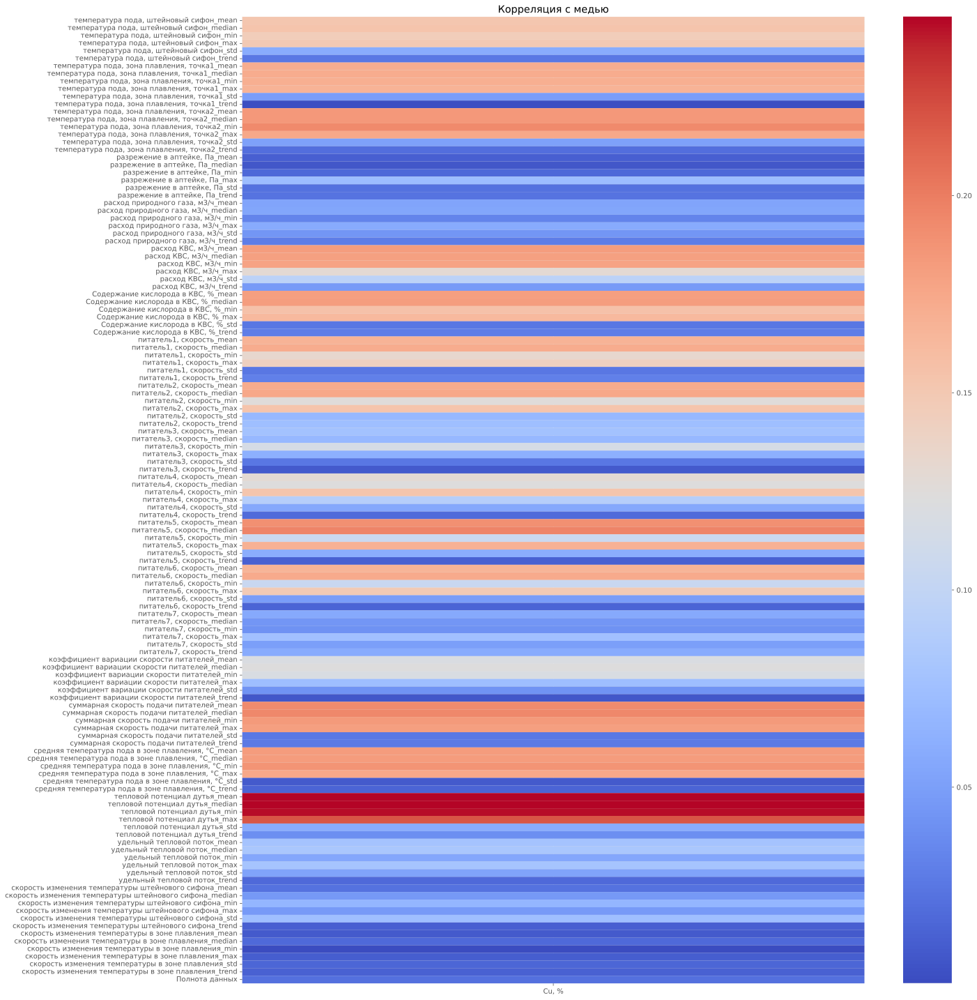

In [1058]:
# Объединение данных
full_df = pd.concat([features_df, targets_df], axis=1)

# Корреляция с целевыми переменными
target_corr = full_df.corr()[targets_df.columns].abs().drop(targets_df.columns)

# Визуализация
plt.figure(figsize=(20, 25))
sns.heatmap(target_corr, cmap='coolwarm')
plt.title("Корреляция с медью")
plt.savefig('Correlation with Targets.png')
plt.show()

In [1059]:
full_df.columns

Index(['температура пода, штейновый сифон_mean',
       'температура пода, штейновый сифон_median',
       'температура пода, штейновый сифон_min',
       'температура пода, штейновый сифон_max',
       'температура пода, штейновый сифон_std',
       'температура пода, штейновый сифон_trend',
       'температура пода, зона плавления, точка1_mean',
       'температура пода, зона плавления, точка1_median',
       'температура пода, зона плавления, точка1_min',
       'температура пода, зона плавления, точка1_max',
       ...
       'скорость изменения температуры штейнового сифона_std',
       'скорость изменения температуры штейнового сифона_trend',
       'скорость изменения температуры в зоне плавления_mean',
       'скорость изменения температуры в зоне плавления_median',
       'скорость изменения температуры в зоне плавления_min',
       'скорость изменения температуры в зоне плавления_max',
       'скорость изменения температуры в зоне плавления_std',
       'скорость изменения те

In [1060]:
# Фильтр, который оставляет признаки, даже если они коррелируют между собой,
# но при этом имеют высокую корреляцию с разными целевыми переменными

def advanced_filter(df, target_columns, feature_corr_thresh=0.9, target_corr_thresh=0.10):
    corr_matrix = df.corr().abs()
    features = [col for col in df.columns if col not in target_columns]
    
    # Для каждого целевого признака находим сильно коррелирующие фичи
    important_for_target = {}
    for target in target_columns:
        important = corr_matrix.index[corr_matrix[target] > target_corr_thresh].tolist()
        important = [f for f in important if f in features]
        important_for_target[target] = important
    
    # Находим пересечения
    from collections import defaultdict
    feature_to_targets = defaultdict(list)
    for target, feats in important_for_target.items():
        for f in feats:
            feature_to_targets[f].append(target)
    
    # Оставляем фичи, которые:
    # 1. Сильно коррелируют с любым целевым И
    # 2. Либо не имеют сильной корреляции с другими фичами, либо
    #    их корреляция с целевыми уникальна (не покрывается другими фичами)
    to_keep = set()
    
    for f, targets in feature_to_targets.items():
        # Находим все фичи, с которыми коррелирует текущая
        correlated = corr_matrix.index[corr_matrix[f] > feature_corr_thresh].tolist()
        correlated = [x for x in correlated if x in features]
        
        if not correlated:  # Если нет корреляций - оставляем
            to_keep.add(f)
        else:
            # Проверяем, покрывают ли другие фичи те же целевые
            other_targets = set()
            for other_f in correlated:
                if other_f != f:
                    other_targets.update(feature_to_targets.get(other_f, []))
            
            current_targets = set(targets)
            if not current_targets.issubset(other_targets):
                to_keep.add(f)
    
    return df[list(to_keep) + target_columns]

# Использование:
filtered_advanced = advanced_filter(full_df, target_columns=['Cu, %'])

In [1061]:
filtered_advanced.shape

(1538, 13)

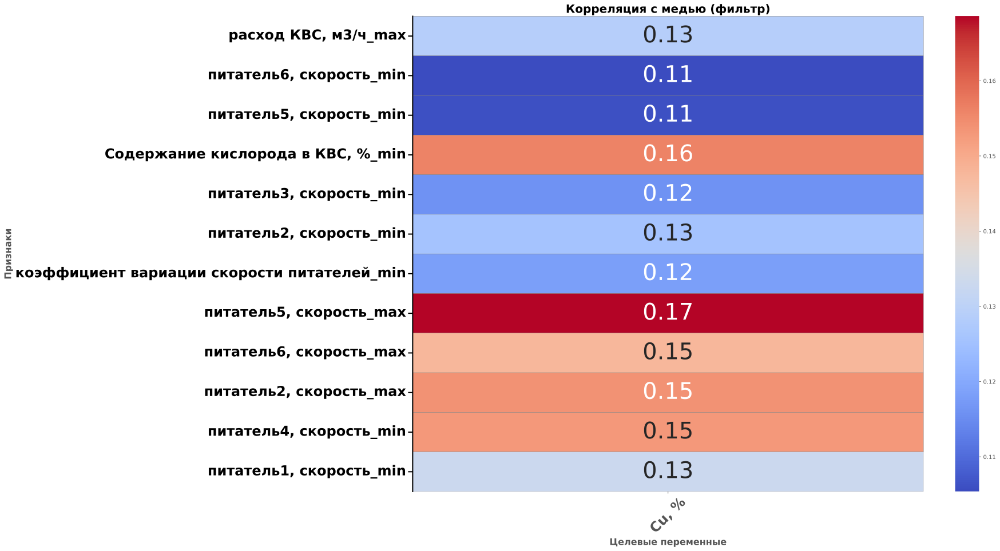

In [1062]:
# Корреляция с целевыми переменными
target_corr = filtered_advanced.corr()[targets_df.columns].abs().drop(targets_df.columns)

# Визуализация
plt.figure(figsize=(20, 15))
sns.heatmap(target_corr, cmap='coolwarm', annot=True, fmt=".2f", cbar=True,
            annot_kws={"fontsize": 40},  # Размер шрифта аннотаций
            linewidths=0.5, linecolor='gray')  

plt.title("Корреляция с медью (фильтр)", fontsize=20, fontweight='bold')  
plt.xlabel("Целевые переменные", fontsize=16, fontweight='bold')  
plt.ylabel("Признаки", fontsize=16, fontweight='bold')  

plt.xticks(fontsize=24, fontweight='bold', rotation=45)  # Метки оси X
plt.yticks(fontsize=24, fontweight='bold', rotation=0)   # Метки оси Y

ax = plt.gca()  
ax.spines['left'].set_visible(True) 
ax.spines['left'].set_linewidth(2)  
ax.spines['left'].set_color('black')  
ax.tick_params(axis='y', which='both', length=8, width=2, colors='black')


plt.grid(axis='y', linestyle='--', linewidth=1, alpha=0.7)

plt.savefig('Correlation_with_Targets_filtered.png', dpi=300, bbox_inches='tight')

plt.show()

# I Training on aggregated DataFrame

In [1063]:
full_df = full_df.drop('Cu, %', axis=1)  #  for tree-based models
filtered_advanced = filtered_advanced.drop('Cu, %', axis=1)  # for linear models
y = targets_df  # with Cu
target_cols = ['Cu, %']

X_train_tree, X_test_tree, y_train_tree, y_test_tree = train_test_split(full_df, y, test_size=0.2, random_state=0) #  for tree-based models
X_train_linear, X_test_linear, y_train_linear, y_test_linear = train_test_split(filtered_advanced, y, test_size=0.2, random_state=0) # for linear models


In [1064]:
# Создание оценщика и score функции
def score_mae_rmse(model):
    y_pred = model.fit(X_train,y_train).predict(X_test)
    RMSE = mean_squared_error(y_test, y_pred)
    MAE = mean_absolute_error(y_test, y_pred)
    return [MAE, RMSE]

def err_DF():
    #models = [lin_regr, lin_sgd, dec_tree, rand_forest]
    arr_MAE =[]
    arr_RMSE=[]
    for model in models:
        MAE, RMSE = score_mae_rmse(model)
        arr_MAE.append(MAE)
        arr_RMSE.append(RMSE)
    return round(pd.DataFrame({'Model':['LinearRegression','SGD','DT','RF'],'MAE':arr_MAE,'RMSE':arr_RMSE}),3)   

## Linear Regression

In [1065]:
# --- Linear Regression ---
linear_pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('model', LinearRegression())
])

linear_pipeline.fit(X_train_linear, y_train_linear)

Pipeline(steps=[('scaler', StandardScaler()), ('model', LinearRegression())])

In [1066]:
y_pred_linear = linear_pipeline.predict(X_test_linear)

mae_linear = mean_absolute_error(y_test_linear, y_pred_linear)
rmse_linear = np.sqrt(mean_squared_error(y_test_linear, y_pred_linear))
print(f"Linear Regression - MAE: {mae_linear}")
print(f"Linear Regression - RMSE: {rmse_linear}")

Linear Regression - MAE: 2.2953134753259983
Linear Regression - RMSE: 3.0346947945049134


Проверка на:
Нормальность
Гомоскедастичность
Автокорреляция

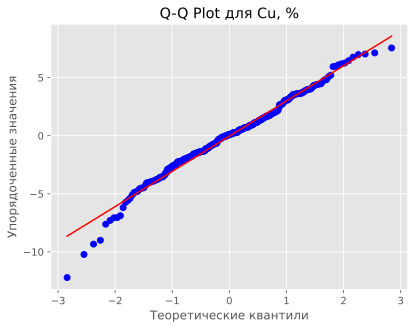

Shapiro-Wilk test for Cu, %: stat=0.9834808819196693, p=0.0012967722916783016


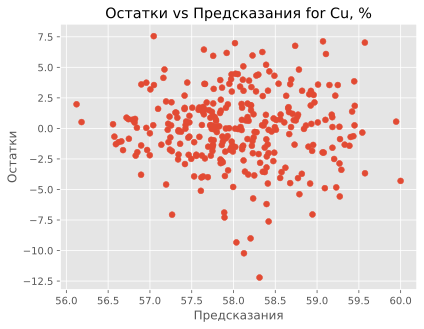

Durbin-Watson for Cu, %: 2.0128865624872687


In [1067]:
# Check assumptions
residuals = y_test_linear - y_pred_linear
for i, col in enumerate(target_cols):
    plt.figure()
    probplot(residuals.iloc[:, i], dist="norm", plot=plt)
    plt.title(f'Q-Q Plot для {col}')
    plt.xlabel('Теоретические квантили')
    plt.ylabel('Упорядоченные значения')
    plt.savefig('Q_Q_Plot_LinearRegression.png')
    plt.show()
    stat, p = shapiro(residuals.iloc[:, i])
    print(f'Shapiro-Wilk test for {col}: stat={stat}, p={p}')
    plt.figure()
    plt.scatter(y_pred_linear[:, i], residuals.iloc[:, i])
    plt.xlabel('Предсказания')
    plt.ylabel('Остатки')
    plt.title(f'Остатки vs Предсказания for {col}')
    plt.savefig('Residuals_LinearRegression.png')
    plt.show()
    dw_stat = durbin_watson(residuals.iloc[:, i])
    print(f'Durbin-Watson for {col}: {dw_stat}')

# RandomForestRegressor

In [1068]:
# --- RandomForestRegressor ---
rf_pipeline = Pipeline([
    ('model', RandomForestRegressor())
])

param_dist_rf = {
    'model__n_estimators': [50, 100, 200],
    'model__max_depth': [None, 10, 20, 30],
    'model__min_samples_split': [2, 5, 10],
    'model__min_samples_leaf': [1, 2, 4]
}

random_search_rf = RandomizedSearchCV(
    rf_pipeline, param_dist_rf, n_iter=20, cv=5,
    scoring='neg_mean_absolute_error', random_state=42, n_jobs=-1
)
random_search_rf.fit(X_train_tree, y_train_tree)
best_rf_model = random_search_rf.best_estimator_

In [1069]:
y_pred_rf = best_rf_model.predict(X_test_tree)

mae_rf = mean_absolute_error(y_test_tree, y_pred_rf)
rmse_rf = np.sqrt(mean_squared_error(y_test_tree, y_pred_rf))
print("RandomForestRegressor - MAE:", mae_rf)
print("RandomForestRegressor - RMSE:", rmse_rf)

RandomForestRegressor - MAE: 2.1371618773212306
RandomForestRegressor - RMSE: 2.7640182100985355


# DecisionTreeRegressor

In [1070]:
# --- DecisionTreeRegressor ---
dt_pipeline = Pipeline([
    ('model', DecisionTreeRegressor())
])

param_dist_dt = {
    'model__max_depth': [None, 10, 20, 30],
    'model__min_samples_split': [2, 5, 10],
    'model__min_samples_leaf': [1, 2, 4]
}

random_search_dt = RandomizedSearchCV(
    dt_pipeline, param_dist_dt, n_iter=20, cv=5,
    scoring='neg_mean_absolute_error', random_state=42, n_jobs=-1
)
random_search_dt.fit(X_train_tree, y_train_tree)

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('model',
                                              DecisionTreeRegressor())]),
                   n_iter=20, n_jobs=-1,
                   param_distributions={'model__max_depth': [None, 10, 20, 30],
                                        'model__min_samples_leaf': [1, 2, 4],
                                        'model__min_samples_split': [2, 5, 10]},
                   random_state=42, scoring='neg_mean_absolute_error')

In [1071]:
best_dt_model = random_search_dt.best_estimator_
y_pred_dt = best_dt_model.predict(X_test_tree)

mae_dt = mean_absolute_error(y_test_tree, y_pred_dt)
rmse_dt = np.sqrt(mean_squared_error(y_test_tree, y_pred_dt))
print("RandomForestRegressor - MAE:", mae_dt)
print("RandomForestRegressor - RMSE:", rmse_dt)

RandomForestRegressor - MAE: 2.735345642409982
RandomForestRegressor - RMSE: 3.4864065209574178


In [1072]:
best_dt_model = random_search_dt.best_estimator_
y_pred_dt = best_dt_model.predict(X_test_tree)

mae_dt = mean_absolute_error(y_test, y_pred_dt)
rmse_dt = np.sqrt(mean_squared_error(y_test, y_pred_dt))
print("DecisionTreeRegressor - MAE:", mae_dt)
print("DecisionTreeRegressor - RMSE:", rmse_dt)

NameError: name 'y_test' is not defined

# SGD Regression

In [1073]:
# --- SGD Regression ---
sgd_pipeline = Pipeline([('scaler', StandardScaler()), ('model',SGDRegressor(tol = 0.0001, eta0 = 0.01,random_state=0))])

sgd_pipeline.fit(X_train_linear, y_train_linear)
y_pred_sgd = sgd_pipeline.predict(X_test_linear)

In [1074]:
mae_sgd = mean_absolute_error(y_test_linear, y_pred_sgd)
rmse_sgd = np.sqrt(mean_squared_error(y_test_linear, y_pred_sgd))
print("SGD Regression - MAE:", mae_sgd)
print("SGD Regression - RMSE:", rmse_sgd)

SGD Regression - MAE: 2.297469002135031
SGD Regression - RMSE: 3.0421248122656586


# I Train Results

In [1075]:
arr_MAE = [mae_linear, mae_sgd, mae_dt, mae_rf]
arr_RMSE = [rmse_linear, rmse_sgd, rmse_dt, rmse_rf]
df_errors = round(pd.DataFrame({'Model':['LinearRegression','SGD','DT','RF'],'MAE':arr_MAE,'RMSE':arr_RMSE}),3)
df_errors

,Model,MAE,RMSE
0,LinearRegression,2.295,3.035
1,SGD,2.297,3.042
2,DT,2.735,3.486
3,RF,2.137,2.764


In [1106]:
# Среднее процентное отклонение 
def calculate_mape(y_true, y_pred):
    y_true = np.array(y_true).flatten()
    y_pred = np.array(y_pred).flatten()
    
    # Проверка на совпадение размеров
    if len(y_true) != len(y_pred):
        raise ValueError(f"Length mismatch: y_true has {len(y_true)}, y_pred has {len(y_pred)}")
    
    # Избежание деления на ноль: замена значений y_true, близких к нулю
    y_true_safe = np.where(np.abs(y_true) < 1e-10, 1e-10, y_true)
    
    # Вычисление MAPE
    mape = np.mean(np.abs((y_true - y_pred) / y_true_safe)) * 100
    return mape

mape_dt = calculate_mape(y_test_tree, y_pred_dt)
print(f"MAPE for DecisionTree: {mape_dt:.2f}%")

mape_rf = calculate_mape(y_test_tree, y_pred_rf)
print(f"MAPE for Random Forest: {mape_rf:.2f}%")

mape_linear = calculate_mape(y_test_linear, y_pred_linear)
print(f"MAPE for LinearRegression: {mape_linear:.2f}%")

MAPE for DecisionTree: 4.76%
MAPE for Random Forest: 3.73%
MAPE for LinearRegression: 4.00%


In [1101]:
def lin_coef_plot(pipeline, model_name, X, y, target_col='Cu, %', top_n=10):

    
    n_bootstraps = 1000
    n_features = X.shape[1]
    
    # Инициализация массива для хранения коэффициентов
    coeffs = np.zeros((n_bootstraps, n_features))
    
    # Bootstrap-выборки и обучение модели
    for i in range(n_bootstraps):
        sample_X, sample_y = resample(X, y)
        pipeline.fit(sample_X, sample_y)
        coeffs[i] = pipeline['model'].coef_  # Форма: (n_features,)
    
    # Создаем DataFrame для коэффициентов
    coef_df = pd.DataFrame(coeffs, columns=X.columns)
    
    median_abs_coefs = coef_df.abs().median().sort_values(ascending=False)
    top_features = median_abs_coefs.head(top_n).index
    coef_df_top = coef_df[top_features]
    
    plt.figure(figsize=(14, 6))
    sns.boxplot(data=coef_df_top, palette='Blues', linewidth=1.5)
    # Добавление значений медиан над boxplot
    medians = coef_df_top.median()
    for i, median in enumerate(medians):
        plt.text(i, median + 0.07 * (coef_df_top.max().max() - coef_df_top.min().min()), 
                 f'{median:.3f}', ha='right', va='bottom', fontsize=9, color='black')
    plt.title(f'Значения коэффициентов ключевых признаков для {target_col} ({model_name})', fontsize=16, pad=20)
    plt.xlabel('Признаки', fontsize=12)
    plt.ylabel('Значения коэффициентов', fontsize=12)
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.yticks(fontsize=10)
    plt.grid(True, linestyle='--', alpha=0.7)
    
    plt.tight_layout()
    
    # Сохранение графика для презентации
    plt.savefig(f'coef_plot_{model_name}.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    #return coef_df


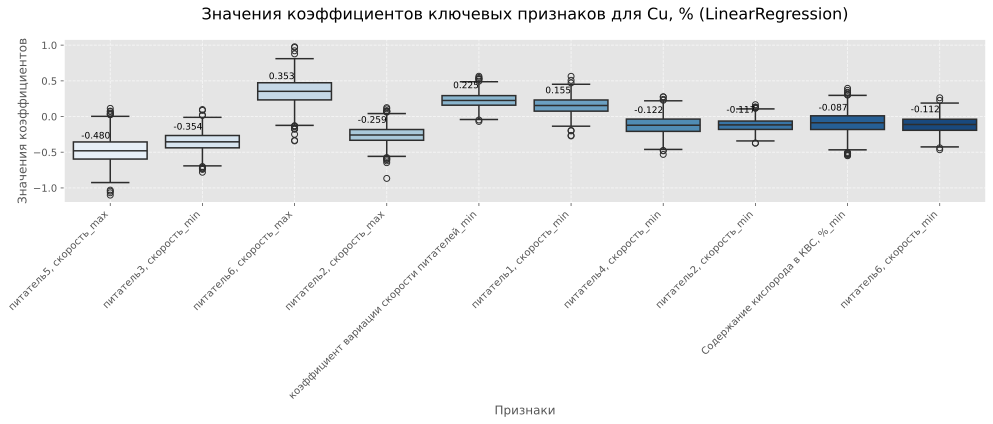

,"расход КВС, м3/ч_max","питатель6, скорость_min","питатель5, скорость_min","Содержание кислорода в КВС, %_min","питатель3, скорость_min","питатель2, скорость_min",коэффициент вариации скорости питателей_min,"питатель5, скорость_max","питатель6, скорость_max","питатель2, скорость_max","питатель4, скорость_min","питатель1, скорость_min"
0,-0.156819,-0.076370,-0.206917,-0.038744,-0.295153,-0.149347,0.104918,-0.301720,0.229323,-0.113793,-0.167184,0.173103
1,0.049202,-0.199261,0.166053,-0.003665,-0.334199,-0.117302,0.180879,-0.619555,0.432658,-0.319585,-0.142370,0.159108
2,-0.070676,-0.014861,-0.036540,-0.113358,-0.415576,-0.150875,0.157273,-0.375604,0.370787,-0.178645,-0.012723,0.089925
3,-0.031226,-0.068747,0.130592,0.216930,-0.547908,-0.274716,0.247462,-0.667372,0.519675,-0.329282,-0.139815,0.005509
4,0.037770,-0.148853,0.169804,-0.064502,-0.471607,0.012193,0.164273,-0.397363,0.166354,-0.462351,0.063970,-0.028486
...,...,...,...,...,...,...,...,...,...,...,...,...
995,-0.038516,-0.042924,0.142217,-0.031104,-0.442494,-0.233774,0.564387,-0.606976,0.624269,-0.162346,-0.199456,0.029855
996,-0.112586,-0.185216,0.038875,-0.083152,-0.380276,-0.034329,0.208103,-0.617235,0.468551,-0.260982,-0.175039,0.187783
997,0.035899,-0.112694,-0.046656,-0.078980,-0.411470,-0.078331,0.126593,-0.273073,0.121394,-0.390309,-0.184243,0.191260
998,-0.190908,-0.288661,0.193703,0.196495,-0.392708,-0.058249,0.307895,-0.424682,0.296955,-0.311187,-0.144700,0.092454


In [1121]:
lin_coef_plot(linear_pipeline, 'LinearRegression', filtered_advanced, y)

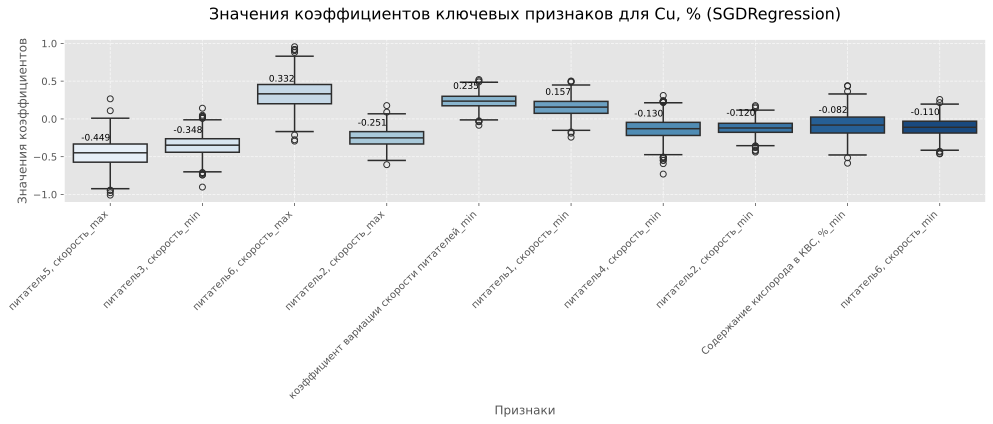

In [1078]:
lin_coef_plot(sgd_pipeline, 'SGDRegression', filtered_advanced, y)

In [1079]:
def woody_coefs_plot(pipeline, model_name, X, top_n=10):
        
    pipeline.fit(X_train_tree, y_train_tree)
    feature_importances = pipeline['model'].feature_importances_
    
    # Сортировка и выбор топ-N признаков
    indices = np.argsort(feature_importances)[-top_n:]  
    top_features = np.array(X.columns)[indices]
    top_importances = feature_importances[indices]
    
    plt.figure(figsize=(12, 6))
    bars = plt.barh(range(top_n), top_importances, color='skyblue', edgecolor='navy')
    
    # Добавление значений важности на концах столбцов
    for i, bar in enumerate(bars):
        width = bar.get_width()
        plt.text(width + 0.01, bar.get_y() + bar.get_height()/2, f'{width:.3f}', 
                 ha='left', va='center', fontsize=9, color='black')
    
    # Настройка осей и заголовка
    plt.yticks(range(top_n), top_features, fontsize=10)
    plt.xlabel('Feature Importance', fontsize=12)
    plt.ylabel('Features', fontsize=12)
    plt.title(f'Топ {top_n} важных признаков для {model_name}', fontsize=16, pad=20)
    plt.grid(True, axis='x', linestyle='--', alpha=0.7)
    
    # Улучшение макета
    plt.tight_layout()
    
    # Сохранение графика для презентации
    plt.savefig(f'feature_importances_{model_name}.png', dpi=300, bbox_inches='tight')
    plt.show()

In [1086]:
def woody_coefs_plot(pipeline, model_name, X, top_n=10):

    
    # Получение важности признаков
    feature_importances = pipeline['model'].feature_importances_
    
    # Сортировка и выбор топ-N признаков
    indices = np.argsort(feature_importances)[-top_n:]  # Топ-N индексов
    top_features = np.array(X.columns)[indices]
    top_importances = feature_importances[indices]
    
    # Построение вертикального bar plot
    plt.figure(figsize=(12, 6))
    bars = plt.bar(range(top_n), top_importances, color='skyblue', edgecolor='navy')
    
    # Добавление значений важности над столбцами
    for i, bar in enumerate(bars):
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, height + 0.01, f'{height:.3f}', 
                 ha='center', va='bottom', fontsize=9, color='black')
    
    # Настройка осей и заголовка
    plt.xticks(range(top_n), top_features, fontsize=10, rotation=45, ha='right')
    plt.ylabel('Feature Importance', fontsize=12)
    plt.xlabel('Features', fontsize=12)
    plt.title(f'Топ {top_n} важных признаков для {model_name}', fontsize=16, pad=20)
    plt.grid(True, axis='y', linestyle='--', alpha=0.7)
    
    # Улучшение макета
    plt.tight_layout()
    
    # Сохранение графика для презентации
    plt.savefig(f'feature_importances_{model_name}.png', dpi=300, bbox_inches='tight')
    plt.show()

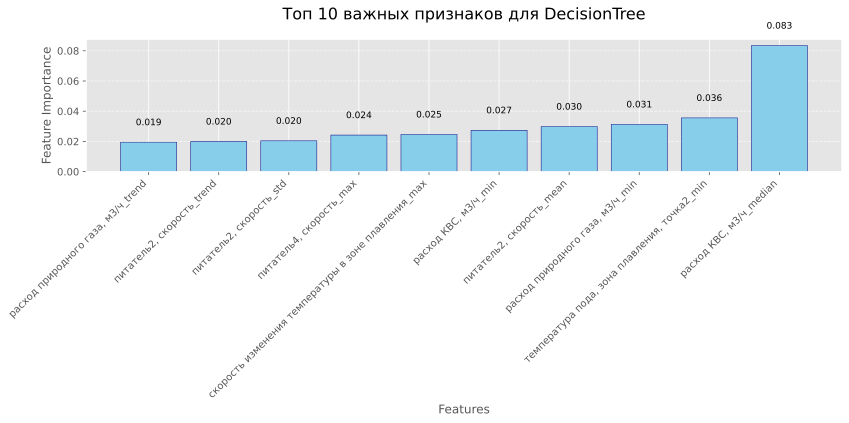

In [1087]:
woody_coefs_plot(dt_pipeline, 'DecisionTree', full_df)

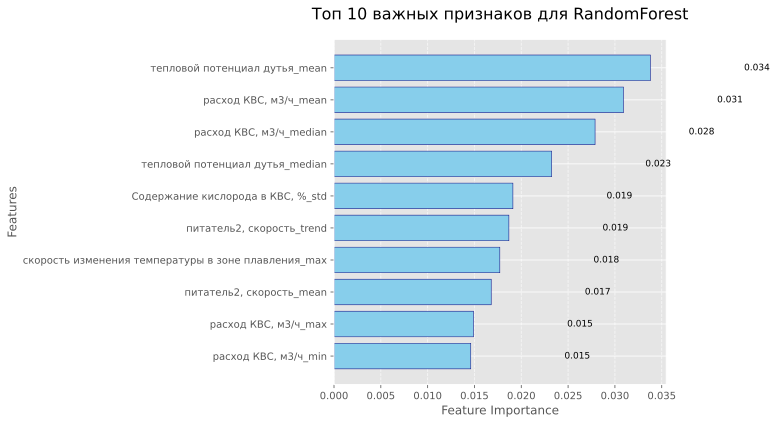

In [1081]:
woody_coefs_plot(rf_pipeline, 'RandomForest', full_df)

In [1126]:
import shap
def shap_analysis(pipeline, X, model_name, top_n=10):
    model = pipeline['model']
    # Инициализация explainer
    explainer = shap.TreeExplainer(model) if hasattr(model, 'tree_') else shap.LinearExplainer(model, X)
    
    # Расчет SHAP-значений
    shap_values = explainer.shap_values(X)
    
    plt.figure(figsize=(12, 6))
    shap.summary_plot(shap_values, X, plot_type="bar", max_display=top_n, show=False, color='skyblue')
    plt.title(f"Топ {top_n} важных признаков (SHAP) для {model_name}", fontsize=16, pad=20)
    plt.xlabel('Среднее |SHAP значение|', fontsize=12)
    plt.ylabel('Признаки', fontsize=12)
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    plt.grid(True, axis='x', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.savefig(f'shap_importance_{model_name}.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    plt.figure(figsize=(12, 6))
    shap.summary_plot(shap_values, X, max_display=top_n, show=False)
    plt.title(f"Распределение SHAP-значений для {model_name}", fontsize=16, pad=20)
    plt.xlabel('SHAP значение', fontsize=12)
    plt.ylabel('Признаки', fontsize=12)
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    plt.grid(True, axis='x', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.savefig(f'shap_distribution_{model_name}.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    return explainer, shap_values

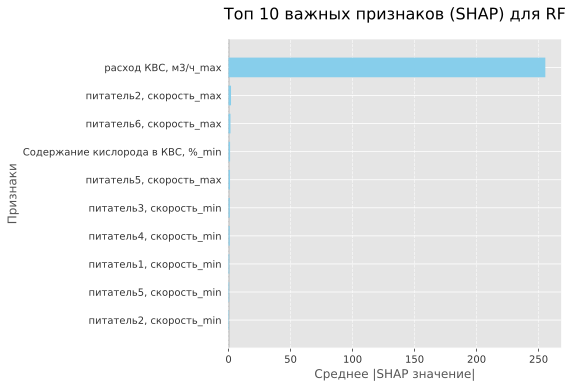

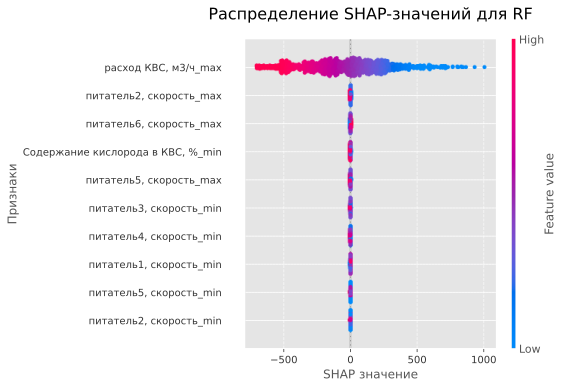

(<shap.explainers._linear.LinearExplainer at 0x1c9b21b19a0>,
 array([[-1.68184203e+02,  2.93575192e-01, -1.50992018e+00, ...,
         -6.23234099e+00, -1.82627931e+00,  1.30790482e+00],
        [ 1.59552198e+02, -8.11556713e-03,  1.00861496e+00, ...,
          5.09713966e+00, -3.04221444e+00, -1.76993191e+00],
        [-4.88278047e+02, -4.46493238e-02,  1.00861496e+00, ...,
          2.00957593e+00, -7.47406835e-01,  6.23169315e-01],
        ...,
        [ 5.00568992e+02, -2.42942740e-01,  1.00861496e+00, ...,
         -3.37852483e-02,  7.45952497e-01, -7.42479468e-01],
        [-9.72930187e+01, -2.42942740e-01, -5.86553464e-01, ...,
         -1.81046382e+00, -1.64903682e+00,  9.94734456e-01],
        [-7.40978126e+01,  2.93230743e-01, -1.05538398e+00, ...,
         -2.10417338e+00, -1.10960059e+00, -4.01154969e-01]]))

In [1124]:
shap_analysis(linear_pipeline, X_train_linear, "RF")

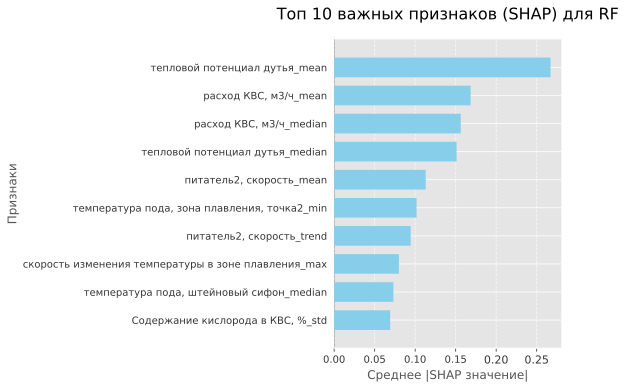

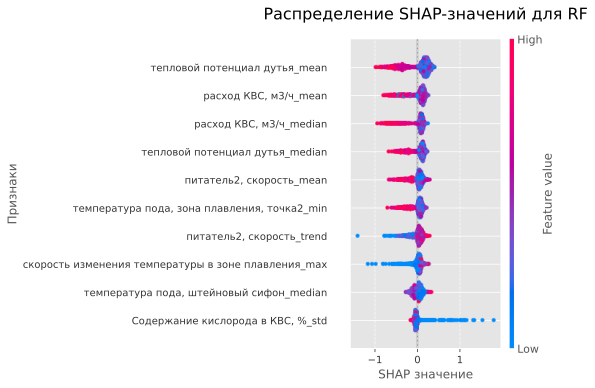

(<shap.explainers._tree.TreeExplainer at 0x1c9be527430>,
 array([[-0.01141517, -0.0988823 , -0.01607036, ...,  0.00900471,
          0.01137561,  0.00736953],
        [-0.00922701,  0.02713175, -0.00547919, ..., -0.00464938,
          0.02939864, -0.00809063],
        [ 0.01577851,  0.04695236, -0.01888348, ..., -0.00751849,
          0.00994439, -0.03054826],
        ...,
        [ 0.04317848,  0.09263708,  0.01347751, ...,  0.00602773,
          0.00785121, -0.00397666],
        [-0.03278464,  0.01428925, -0.01409036, ..., -0.04110263,
          0.01181506,  0.00314452],
        [-0.02041981, -0.06427357, -0.01229152, ..., -0.00374488,
          0.03745147,  0.01752037]]))

In [1127]:
shap_analysis(rf_pipeline, X_train_tree, "RF")

In [1133]:
# Получение важности признаков
feature_importances = rf_pipeline['model'].feature_importances_

# Сортировка и выбор топ-N признаков
indices = np.argsort(feature_importances)[-10:]  # Топ-N индексов
top_features = np.array(X_train_tree.columns)[indices]

In [1134]:
top_features

array(['расход КВС, м3/ч_min', 'расход КВС, м3/ч_max',
       'питатель2, скорость_mean',
       'скорость изменения температуры в зоне плавления_max',
       'питатель2, скорость_trend', 'Содержание кислорода в КВС, %_std',
       'тепловой потенциал дутья_median', 'расход КВС, м3/ч_median',
       'расход КВС, м3/ч_mean', 'тепловой потенциал дутья_mean'],
      dtype=object)

In [1141]:
def interaction_analysis(X, y, top_features):
    analysis_df = X[top_features].copy()
    analysis_df['Cu'] = y
    
    sns.pairplot(analysis_df.sample(1000), 
                 x_vars=top_features[:3], 
                 y_vars=['Cu'], 
                 kind='reg', 
                 plot_kws={'line_kws':{'color':'red'}})
    
    plt.figure(figsize=(12, 10))
    corr_matrix = analysis_df.corr()
    sns.heatmap(corr_matrix[(corr_matrix['Cu'] > 0.1) | (corr_matrix['Cu'] < -0.1)], 
                annot=True, cmap='coolwarm', center=0)
    plt.title('Корреляции с содержанием Cu')
    plt.tight_layout()
    plt.savefig('cu_correlations.png', dpi=300)
    plt.show()

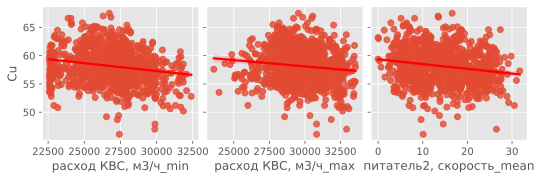

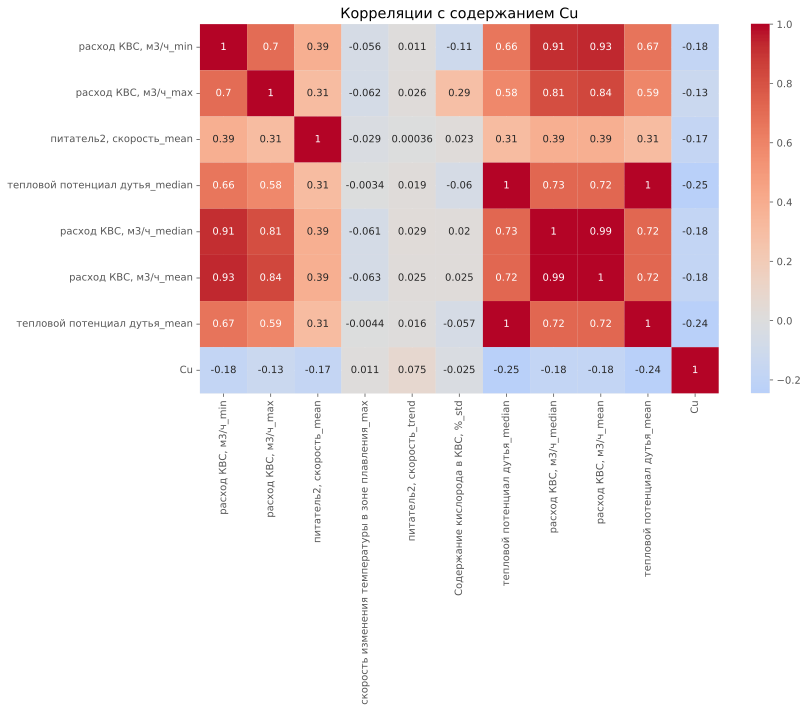

In [1142]:
interaction_analysis(full_df, y, top_features)

In [ ]:
# КРИВЫЕ ОБУЧЕНИЯ
def plot_learning_curve(estimator, model_name, X, y, ylim=None, cv=5, train_sizes=np.linspace(.1, 1.0, 5)):
    plt.Figure()
    plt.title(f"Learning curve {model_name}")
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Train examples")
    plt.ylabel("RMSE")
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=cv, n_jobs=-1, train_sizes=train_sizes, scoring=rmse_scorer_plot)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    plt.grid()

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                    train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                    test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Train RMSE")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g",
             label="C-V RMSE")

    plt.legend(loc="best")
    return plt

In [ ]:
plot_learning_curve(lin_regr, 
                    "Linear Regression", 
                    X_train, 
                    y_train);

In [ ]:
plot_learning_curve(lin_sdg, 
                    "SGDRegressor", 
                    X_train, 
                    y_train);

In [ ]:
plot_learning_curve(dec_tree, 
                    "Decision Tree", 
                    X_train,
                    y_train, cv=3);

In [ ]:
plot_learning_curve(rand_forest, 
                    "Random Forest tuned", 
                    X_train, 
                    y_train, cv=3);

1. Если модели недообучаются, можно добавить полиномиальные черты для линейных моделей или усложнить модели на деревьях. Это поможет улучшить производительность.
2. При переобучении усиливаю регуляризацию для линейных моделей или упрощаю деревья, например, уменьшая max_depth. Это снизит риск переобучения.

Все не переобучены кроме RF, как помочь:

RF:

Получите больше данных для обучения

Попробуйте меньший набор показателей

Используйте менее сложную модель

Добавьте регуляризацию

Остальные:

Попробуйте увеличить число показателей

Перейдите на более сложную модель



# Точечные графики признаков

# Графики предсказаний


# Графики остатков, проверка на гетероскедастичность

# Save model for deployment

In [1176]:
#сериализация
from joblib import dump
dump(model, 'LIN_model.joblib')

['LIN_model.joblib']

# Pipeline and Feature Selection

In [ ]:
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import Lasso

In [ ]:
#выбор фичей из RF, резултат хуже
pipe = make_pipeline(PolynomialFeatures(),StandardScaler(),SelectFromModel(estimator=RandomForestRegressor()),LinearRegression())
preddd = pipe.fit(X_train,y_train).predict(X_test)
metrics.mean_squared_error(y_test,preddd,squared=False)

In [ ]:
# пример работы SelectFromModel
selector = SelectFromModel(estimator=RandomForestRegressor()).fit(X_train,y_train)
selector.estimator_.feature_importances_

In [ ]:
selector.threshold_

In [ ]:
selector.transform(X_train)

Перебор фичей

Начинаем с полного пространства признаков и выкидываем признаки по одному, пока это не портит качество модели или пока не достигнуто желаемое число признаков.

In [ ]:
from sklearn.feature_selection import SequentialFeatureSelector
selector = SequentialFeatureSelector(LinearRegression(), scoring='neg_mean_squared_error',cv=5, n_features_to_select=3, n_jobs=-1)
selector.fit(X_train_poly, y_train_poly)

In [ ]:
selector.transform(X_train_poly)

In [ ]:
#NORMALITY
#consider normality of all features
from scipy.stats import norm
from scipy import stats
sns.distplot(Y, fit=norm);
fig = plt.figure()
res = stats.probplot(Y, plot=plt)

In [ ]:
#Does np.log helped - NOPE
sns.distplot(X.iloc[:,0], fit=norm);
fig = plt.figure()
res = stats.probplot(Y, plot=plt)

In [ ]:
#NOPE
sns.distplot(stats.boxcox(X.iloc[:,1])[0], fit=norm);
fig = plt.figure()
res = stats.probplot(Y, plot=plt)

In [ ]:
#NOPE
sns.distplot(X.iloc[:,2], fit=norm);
fig = plt.figure()
res = stats.probplot(Y, plot=plt)

In [ ]:
#YES
sns.distplot(X.iloc[:,3], fit=norm);
fig = plt.figure()
res = stats.probplot(Y, plot=plt)

In [ ]:
#NOPE
sns.distplot(X.iloc[:,4], fit=norm);
fig = plt.figure()
res = stats.probplot(Y, plot=plt)

In [ ]:
#test T-SNE
from sklearn.manifold import TSNE
import plotly.express as px
embed = TSNE(random_state =42, perplexity=10.0,n_jobs=-1,n_iter=5000)

In [ ]:
X_embedded = embed.fit_transform(X)
print('New Shape of X: ', X_embedded.shape)
print('Kullback-Leibler divergence after optimization: ', embed.kl_divergence_)
print('No. of iterations: ', embed.n_iter_)

In [ ]:
# Создание диаграммы разброса
fig = px.scatter(None, x=X_embedded[:,0], y=X_embedded[:,1], 
                 labels={
                     "x": "Dimension 1",
                     "y": "Dimension 2",
                 },
                 opacity=1, color=X_embedded[:,1].astype(str))

# Изменение цвета фона графика
fig.update_layout(dict(plot_bgcolor = 'white'))

# Обновление линий осей
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='lightgrey', 
                 zeroline=True, zerolinewidth=1, zerolinecolor='lightgrey', 
                 showline=True, linewidth=1, linecolor='black')

fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='lightgrey', 
                 zeroline=True, zerolinewidth=1, zerolinecolor='lightgrey', 
                 showline=True, linewidth=1, linecolor='black')

# Установка названия рисунка
fig.update_layout(title_text="t-SNE")

# Обновление размера маркера
fig.update_traces(marker=dict(size=3))

fig.show()

In [ ]:
# уменьшаем размерность и проверяем на RF
from sklearn import decomposition
pca = decomposition.PCA(n_components=2)
X_centered = X - X.mean(axis=0)
pca.fit(X_centered)
X_pca = pca.transform(X_centered)


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_pca, Y, test_size=.3,random_state=42)
search_forest.fit(X_train, y_train)

In [ ]:
preds = search_forest.predict(X_test)
metrics.mean_absolute_error(y_test, preds)

In [ ]:
df_errors

In [ ]:
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly import graph_objs as go
def plotly_df(df, title = ''):
    data = []

    for column in df.columns:
        trace = go.Scatter(
            x = df.index,
            y = df[column],
            mode = 'lines',
            name = column
        )
        data.append(trace)

    layout = dict(title = title)
    fig = dict(data = data, layout = layout)
    iplot(fig, show_link=False)

In [ ]:
df1=pd.read_csv('df1.csv', index_col=['дата'],parse_dates=['дата'])

In [ ]:
plotly_df(df1[['[Cu]','[Fe]']], title = "Cu")